***this n-gram includes whitespaces***

In [1]:
%pip install decorator==5.0.9

import imp
import numpy as np
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity
import matplotlib.pyplot as plt
import networkx as nx
import seaborn as sns


Note: you may need to restart the kernel to use updated packages.


In [2]:
# importing local modules

import sys
sys.path.append('../src/')

import text_cleanup.text_cleanup as thesisCleanUp
import preprocessing.text_preprocessing as thesisTextPreprocessing
import data.reader as thesisDataReader
import utils.utils as thesisUtils

imp.reload(thesisCleanUp)
imp.reload(thesisTextPreprocessing)
imp.reload(thesisDataReader)
imp.reload(thesisUtils)

<module 'utils.utils' from '../src/utils/utils.py'>

In [3]:
a_zwickau_text = thesisDataReader.read_a_zwickau()
b_london_text = thesisDataReader.read_b_london()

In [4]:
a_zwickau_corpus = thesisCleanUp.create_corpus_by_line(thesisCleanUp.jvtext(a_zwickau_text))
b_london_corpus = thesisCleanUp.create_corpus_by_line(thesisCleanUp.jvtext(b_london_text))

In [5]:
def get_features(corpus):
    vectorizer = TfidfVectorizer(ngram_range=(5,5), analyzer='char')
    sparse_matrix = vectorizer.fit_transform(corpus)
    doc_term_matrix = sparse_matrix.todense()
    df = pd.DataFrame(doc_term_matrix, columns=vectorizer.get_feature_names())
    return df

In [6]:
a_zwickau_df = get_features(a_zwickau_corpus)
a_zwickau_similarities = cosine_similarity(a_zwickau_df, a_zwickau_df)

b_london_df = get_features(b_london_corpus)
b_london_similarities = cosine_similarity(b_london_df, b_london_df)

In [7]:
def show_similarities_data(similarities):
    for index, value in enumerate(similarities):
        max_indices = thesisUtils.get_n_indexes_of_max_values(value, 6)
        print('___ max similariry for paragraph: {} ___'.format(index))
        for i in max_indices:
            print('index: [{}] value: {}'.format(i, similarities[index][i]))
        print('average: {}'.format(np.average(value)))

        unique, counts = np.unique(value, return_counts=True)
        unique_dictionary = dict(zip(unique, counts))
        print('0 similarities: {}'.format(unique_dictionary.get(0.0)))

        print()

In [8]:
show_similarities_data(a_zwickau_similarities)

___ max similariry for paragraph: 0 ___
index: [6] value: 0.05278828547759499
index: [46] value: 0.06426263932515161
index: [49] value: 0.0653438387642611
index: [19] value: 0.06747636485449873
index: [321] value: 0.12052507974812625
index: [0] value: 1.0000000000000004
average: 0.01020422857950413
0 similarities: 137

___ max similariry for paragraph: 1 ___
index: [301] value: 0.07536129034285881
index: [196] value: 0.08273434436354274
index: [283] value: 0.0903595461468173
index: [5] value: 0.09628470919515576
index: [6] value: 0.103352716404797
index: [1] value: 1.0000000000000018
average: 0.03416423962961289
0 similarities: 3

___ max similariry for paragraph: 2 ___
index: [289] value: 0.06333862104829924
index: [214] value: 0.06599492052481393
index: [5] value: 0.0695374297163492
index: [211] value: 0.08850655784366854
index: [212] value: 0.09775650698922299
index: [2] value: 1.000000000000002
average: 0.026282606822729197
0 similarities: 4

___ max similariry for paragraph: 3 ___

index: [195] value: 0.22490898064441187
index: [196] value: 1.0000000000000002
average: 0.04157114156513695
0 similarities: None

___ max similariry for paragraph: 197 ___
index: [172] value: 0.11441780809603015
index: [213] value: 0.11915668016868992
index: [200] value: 0.12094819565505474
index: [199] value: 0.12384484078657554
index: [184] value: 0.1268452882791322
index: [197] value: 0.9999999999999997
average: 0.036858969020378024
0 similarities: None

___ max similariry for paragraph: 198 ___
index: [197] value: 0.06026894363114173
index: [64] value: 0.06136827569838043
index: [199] value: 0.06196591821590274
index: [213] value: 0.06290278292482415
index: [105] value: 0.06441583577220225
index: [198] value: 0.9999999999999998
average: 0.024220296596624013
0 similarities: 4

___ max similariry for paragraph: 199 ___
index: [101] value: 0.06923035584549492
index: [192] value: 0.07284996643574729
index: [68] value: 0.09251859246605511
index: [200] value: 0.10424231122414616
index: [

In [9]:
show_similarities_data(b_london_similarities)

___ max similariry for paragraph: 0 ___
index: [317] value: 0.06499898382292515
index: [272] value: 0.06854155477048086
index: [266] value: 0.07062443331756159
index: [21] value: 0.070893250220416
index: [19] value: 0.07919348183643231
index: [0] value: 1.0
average: 0.010784786641239816
0 similarities: 163

___ max similariry for paragraph: 1 ___
index: [187] value: 0.0760811772482333
index: [225] value: 0.0765200425833517
index: [205] value: 0.08098401512753935
index: [5] value: 0.08267999779692083
index: [275] value: 0.08468654178646012
index: [1] value: 1.0000000000000002
average: 0.03575287833824198
0 similarities: None

___ max similariry for paragraph: 2 ___
index: [311] value: 0.06659094120594367
index: [281] value: 0.06959218736679415
index: [5] value: 0.07271839245782237
index: [218] value: 0.07633864095842065
index: [220] value: 0.07905669714951408
index: [2] value: 1.0000000000000002
average: 0.028981358285419024
0 similarities: 2

___ max similariry for paragraph: 3 ___
ind

index: [85] value: 0.11300001521641262
index: [91] value: 0.15177295130371296
index: [84] value: 1.0000000000000013
average: 0.03570264597752485
0 similarities: 2

___ max similariry for paragraph: 85 ___
index: [102] value: 0.12331973417017075
index: [91] value: 0.14150491077719785
index: [232] value: 0.15247417494890897
index: [86] value: 0.16636784221502574
index: [74] value: 0.19384056573634503
index: [85] value: 0.9999999999999992
average: 0.04695680297790088
0 similarities: 1

___ max similariry for paragraph: 86 ___
index: [6] value: 0.07545948690154014
index: [118] value: 0.07852886436145207
index: [61] value: 0.1096260522384909
index: [74] value: 0.14383725884806253
index: [85] value: 0.16636784221502574
index: [86] value: 1.000000000000001
average: 0.033832429369469334
0 similarities: 1

___ max similariry for paragraph: 87 ___
index: [68] value: 0.10133507085921872
index: [84] value: 0.10726636423204121
index: [76] value: 0.10945588219023368
index: [67] value: 0.135998353344

index: [189] value: 1.000000000000001
average: 0.028667258177765775
0 similarities: 1

___ max similariry for paragraph: 190 ___
index: [195] value: 0.10023657169638682
index: [164] value: 0.10821319983457771
index: [220] value: 0.12031127530025153
index: [188] value: 0.157027037132018
index: [191] value: 0.16430162404022483
index: [190] value: 1.0000000000000002
average: 0.040548051419163636
0 similarities: None

___ max similariry for paragraph: 191 ___
index: [163] value: 0.12458817932236171
index: [164] value: 0.12465559142963227
index: [188] value: 0.1251398377461925
index: [166] value: 0.12802994558818273
index: [190] value: 0.16430162404022483
index: [191] value: 0.9999999999999994
average: 0.04944862891718418
0 similarities: 1

___ max similariry for paragraph: 192 ___
index: [185] value: 0.14496796936657724
index: [205] value: 0.14971201353019922
index: [163] value: 0.15991221938433514
index: [225] value: 0.16337143565360104
index: [162] value: 0.16590500955358095
index: [192]

0 similarities: None

___ max similariry for paragraph: 295 ___
index: [275] value: 0.11460994822607083
index: [296] value: 0.12291345972106499
index: [293] value: 0.1280225087965139
index: [291] value: 0.13066941946804908
index: [154] value: 0.26069774390479866
index: [295] value: 0.9999999999999996
average: 0.05229195279881965
0 similarities: None

___ max similariry for paragraph: 296 ___
index: [275] value: 0.08146377795461451
index: [204] value: 0.08295949120647043
index: [25] value: 0.08409034235749636
index: [295] value: 0.12291345972106499
index: [154] value: 0.1338478105803991
index: [296] value: 0.9999999999999989
average: 0.030014119397666194
0 similarities: 1

___ max similariry for paragraph: 297 ___
index: [273] value: 0.07927273722962037
index: [222] value: 0.08157125851368179
index: [267] value: 0.08508295485823754
index: [293] value: 0.08768611184600486
index: [25] value: 0.09412552602387723
index: [297] value: 0.9999999999999987
average: 0.035431533098572145
0 similar

In [10]:
def get_max_similarity_per_p(similarities):
    res = []
    for index, value in enumerate(similarities):
        max_indices = thesisUtils.get_n_indexes_of_max_values(value, 6)
        max_indices_without_self = max_indices[:-1]
        max_similarity = value[max_indices_without_self[-1]]
        res.append(max_similarity)
    return res

In [11]:
a_zwickau_max_similarity_per_p = get_max_similarity_per_p(a_zwickau_similarities)
b_london_max_similarity_per_p = get_max_similarity_per_p(b_london_similarities)


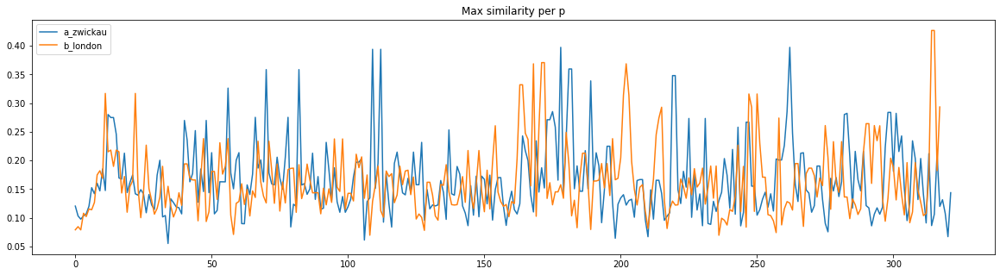

In [12]:
%matplotlib inline
fig, ax = plt.subplots(figsize=(20, 5))
ax.plot(a_zwickau_max_similarity_per_p, label="a_zwickau")
ax.plot(b_london_max_similarity_per_p, label="b_london")
ax.legend()
plt.title('Max similarity per p')
plt.show()

In [13]:
def cross_version_similarity(version_1_corpus, version_2_corpus):
    res = []
    for i, p in enumerate(version_1_corpus):
        temp_corpus = [p] + version_2_corpus
        df_features = get_features(temp_corpus)
        temp_similarities = cosine_similarity(df_features, df_features)
        res.append(temp_similarities[0])
    return res

In [14]:
a_zwickau_b_london_similarities = cross_version_similarity(a_zwickau_corpus, b_london_corpus)
b_london_a_zwickau_similarities = cross_version_similarity(b_london_corpus, a_zwickau_corpus)


In [15]:
show_similarities_data(a_zwickau_b_london_similarities)

___ max similariry for paragraph: 0 ___
index: [210] value: 0.04851270506848557
index: [318] value: 0.0552172211354611
index: [21] value: 0.07264066225587042
index: [20] value: 0.10404211028921988
index: [9] value: 0.1267439343122893
index: [0] value: 1.0000000000000004
average: 0.011107305918511487
0 similarities: 131

___ max similariry for paragraph: 1 ___
index: [314] value: 0.07655343485468982
index: [206] value: 0.07941375726815808
index: [6] value: 0.0869722272134755
index: [276] value: 0.09291379200386475
index: [2] value: 0.7836500102908033
index: [0] value: 1.0000000000000007
average: 0.038341058500006825
0 similarities: None

___ max similariry for paragraph: 2 ___
index: [282] value: 0.06461556701135576
index: [6] value: 0.07015003513853275
index: [219] value: 0.07417355730952585
index: [221] value: 0.0767225121404227
index: [3] value: 0.8722870157819793
index: [0] value: 1.0000000000000002
average: 0.030010898313027806
0 similarities: 2

___ max similariry for paragraph: 3

index: [174] value: 0.7498544357189465
index: [0] value: 0.9999999999999994
average: 0.04312969133381142
0 similarities: 1

___ max similariry for paragraph: 184 ___
index: [224] value: 0.1253583015692065
index: [193] value: 0.12869081901604662
index: [186] value: 0.13929841113311947
index: [184] value: 0.14535351937870777
index: [175] value: 0.6511715011616481
index: [0] value: 1.000000000000001
average: 0.0505337445337561
0 similarities: None

___ max similariry for paragraph: 185 ___
index: [94] value: 0.1065558246189205
index: [161] value: 0.1081512521249261
index: [178] value: 0.1513778519722104
index: [206] value: 0.1661530312555588
index: [177] value: 0.6097868070815415
index: [0] value: 1.0000000000000002
average: 0.04624324325319538
0 similarities: 1

___ max similariry for paragraph: 186 ___
index: [206] value: 0.08453888859658157
index: [193] value: 0.08835940312989822
index: [63] value: 0.12160110833332788
index: [177] value: 0.12370086896358105
index: [178] value: 0.589648

In [16]:
show_similarities_data(b_london_a_zwickau_similarities)

___ max similariry for paragraph: 0 ___
index: [21] value: 0.05235466252319284
index: [138] value: 0.06135077930530341
index: [281] value: 0.06680806740551433
index: [219] value: 0.07090459696786378
index: [275] value: 0.0719090897079153
index: [0] value: 1.0
average: 0.011075427760344828
0 similarities: 177

___ max similariry for paragraph: 1 ___
index: [197] value: 0.07582789873798582
index: [284] value: 0.08437156596195919
index: [6] value: 0.08917482887408834
index: [7] value: 0.09492621659738017
index: [2] value: 0.7829707997215404
index: [0] value: 0.9999999999999987
average: 0.03543265055702891
0 similarities: 3

___ max similariry for paragraph: 2 ___
index: [6] value: 0.06968434761474673
index: [284] value: 0.0727938530895183
index: [212] value: 0.09319722537639134
index: [213] value: 0.0972601054685256
index: [3] value: 0.8732173765781118
index: [0] value: 0.9999999999999996
average: 0.03091046742634512
0 similarities: 4

___ max similariry for paragraph: 3 ___
index: [184] 

index: [57] value: 0.29053332727947895
index: [71] value: 0.4132666597386574
index: [83] value: 0.7291435496346611
index: [0] value: 1.0000000000000002
average: 0.05977075795636028
0 similarities: None

___ max similariry for paragraph: 72 ___
index: [300] value: 0.1117761395620708
index: [61] value: 0.12718305757349962
index: [72] value: 0.14398891683566764
index: [79] value: 0.1476756800508987
index: [58] value: 0.2302829080465362
index: [0] value: 1.0
average: 0.038708555987403505
0 similarities: 1

___ max similariry for paragraph: 73 ___
index: [300] value: 0.12214647093547784
index: [76] value: 0.12377827962201941
index: [64] value: 0.14098650098953572
index: [24] value: 0.14430487344341392
index: [74] value: 0.5990781305664936
index: [0] value: 0.9999999999999997
average: 0.0517572974778453
0 similarities: None

___ max similariry for paragraph: 74 ___
index: [77] value: 0.12152118446626577
index: [298] value: 0.12892466155795676
index: [300] value: 0.13642358481552366
index: [7

index: [186] value: 0.6125576208533247
index: [0] value: 1.000000000000001
average: 0.04484742647701356
0 similarities: 1

___ max similariry for paragraph: 177 ___
index: [263] value: 0.07789714847047935
index: [189] value: 0.08057838791017007
index: [65] value: 0.09090435108695169
index: [186] value: 0.15691570235072166
index: [187] value: 0.6014153235630247
index: [0] value: 1.0
average: 0.03397944211382504
0 similarities: 1

___ max similariry for paragraph: 178 ___
index: [85] value: 0.11210224012697331
index: [185] value: 0.13412293589207297
index: [263] value: 0.140444452604127
index: [166] value: 0.16997294541276448
index: [188] value: 0.7956319908262007
index: [0] value: 1.0000000000000002
average: 0.03068850117487493
0 similarities: 8

___ max similariry for paragraph: 179 ___
index: [264] value: 0.10063352330415395
index: [184] value: 0.10371386357546128
index: [179] value: 0.10640632310852816
index: [101] value: 0.1103593956391736
index: [189] value: 0.6344882012549513
inde

average: 0.04057746239549986
0 similarities: 3

___ max similariry for paragraph: 282 ___
index: [292] value: 0.11356110626293045
index: [290] value: 0.11795814022034787
index: [295] value: 0.11925468537364649
index: [280] value: 0.14325938013771308
index: [291] value: 0.8636461078979357
index: [0] value: 1.000000000000004
average: 0.039905893897658064
0 similarities: 1

___ max similariry for paragraph: 283 ___
index: [281] value: 0.06508856054523611
index: [297] value: 0.08129425847497655
index: [293] value: 0.08635449588140041
index: [291] value: 0.13788201367931754
index: [292] value: 0.9102043863527823
index: [0] value: 0.9999999999999987
average: 0.02645750174846482
0 similarities: 3

___ max similariry for paragraph: 284 ___
index: [297] value: 0.06884742274460122
index: [289] value: 0.07180333989260444
index: [283] value: 0.08443554213498823
index: [291] value: 0.10026591229351818
index: [293] value: 0.8920112833733014
index: [0] value: 0.9999999999999997
average: 0.02014438728

In [17]:
a_zwickau_b_london_max_similarity_per_p = get_max_similarity_per_p(a_zwickau_b_london_similarities)
b_london_a_zwickau_max_similarity_per_p = get_max_similarity_per_p(b_london_a_zwickau_similarities)

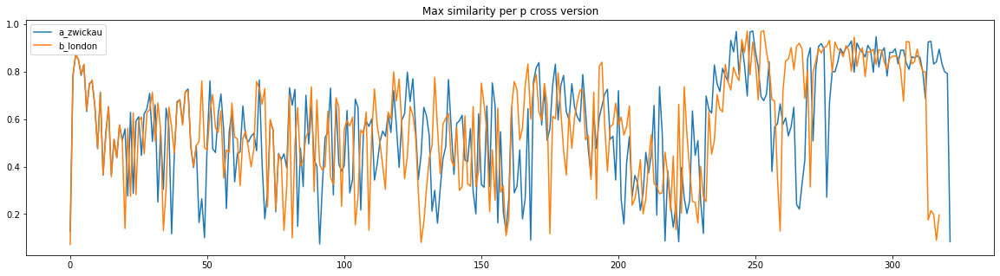

In [18]:
fig, ax = plt.subplots(figsize=(20, 5))
ax.plot(a_zwickau_b_london_max_similarity_per_p, label="a_zwickau")
ax.plot(b_london_a_zwickau_max_similarity_per_p, label="b_london")
ax.legend()
plt.title('Max similarity per p cross version')
plt.show()

In [19]:
def create_G_of_similaritis(similarities):
    G = nx.Graph()
    for index, value in enumerate(similarities):
        max_indices = thesisUtils.get_n_indexes_of_max_values(value, 6)
        max_indices_without_self = max_indices[:-1]
        G.add_node(index) # node himself
        for n in max_indices_without_self:
            G.add_node(n)
            weight = similarities[index][n]
            G.add_weighted_edges_from([(index, n, weight)])
    return G

In [20]:
def show_G(G):
    %matplotlib notebook

    fig = plt.figure(figsize=(10, 10))
    fig.canvas.manager.full_screen_toggle()

    pos=nx.spring_layout(G)
    nx.draw(
        G, 
        pos,
        with_labels=True, 
    )
    fig.show()

In [21]:
a_zwickau_G = create_G_of_similaritis(a_zwickau_similarities)
b_london_G = create_G_of_similaritis(b_london_similarities)

In [22]:
print(len(list(nx.connected_components(a_zwickau_G))))
print(len(list(nx.connected_components(b_london_G))))

1
1


In [23]:
a_zwickau_sorted_degree = sorted(a_zwickau_G.degree, key=lambda x: x[1], reverse=True)
print(a_zwickau_sorted_degree)

[(299, 32), (169, 30), (87, 29), (283, 28), (301, 21), (282, 21), (281, 20), (297, 20), (280, 19), (152, 17), (54, 16), (173, 16), (182, 15), (105, 14), (184, 14), (12, 13), (262, 13), (88, 12), (279, 12), (70, 12), (59, 12), (82, 12), (30, 12), (76, 12), (192, 12), (175, 12), (255, 12), (6, 11), (211, 11), (318, 11), (9, 11), (21, 11), (123, 11), (86, 11), (74, 11), (5, 10), (24, 10), (23, 10), (36, 10), (213, 10), (200, 10), (84, 10), (174, 10), (236, 10), (313, 9), (13, 9), (15, 9), (42, 9), (71, 9), (104, 9), (137, 9), (77, 9), (225, 9), (140, 9), (176, 9), (263, 9), (290, 9), (19, 8), (289, 8), (185, 8), (11, 8), (224, 8), (22, 8), (73, 8), (64, 8), (35, 8), (53, 8), (274, 8), (138, 8), (95, 8), (101, 8), (246, 8), (249, 8), (167, 8), (120, 8), (114, 8), (141, 8), (161, 8), (284, 8), (258, 8), (219, 8), (160, 8), (163, 8), (264, 8), (257, 8), (178, 8), (215, 8), (316, 8), (46, 7), (196, 7), (214, 7), (197, 7), (121, 7), (18, 7), (110, 7), (149, 7), (239, 7), (25, 7), (247, 7), (52

In [24]:
b_london_sorted_degree = sorted(b_london_G.degree, key=lambda x: x[1], reverse=True)
print(b_london_sorted_degree)

[(162, 28), (192, 26), (275, 23), (164, 23), (163, 21), (205, 20), (291, 20), (55, 18), (80, 17), (71, 17), (202, 16), (272, 15), (25, 15), (289, 15), (82, 14), (73, 14), (97, 14), (274, 14), (317, 13), (74, 13), (51, 13), (235, 13), (153, 13), (293, 13), (313, 13), (151, 12), (31, 12), (118, 12), (85, 12), (315, 12), (197, 12), (208, 12), (98, 11), (233, 11), (101, 11), (314, 11), (129, 11), (5, 10), (176, 10), (83, 10), (209, 10), (20, 10), (56, 10), (147, 10), (303, 10), (231, 10), (261, 10), (172, 10), (266, 9), (187, 9), (281, 9), (218, 9), (271, 9), (18, 9), (46, 9), (22, 9), (144, 9), (92, 9), (158, 9), (102, 9), (165, 9), (50, 9), (273, 9), (59, 9), (228, 9), (76, 9), (106, 9), (174, 9), (130, 9), (292, 9), (204, 9), (203, 9), (308, 9), (282, 9), (160, 8), (195, 8), (37, 8), (89, 8), (305, 8), (27, 8), (13, 8), (115, 8), (14, 8), (105, 8), (54, 8), (42, 8), (26, 8), (310, 8), (38, 8), (36, 8), (178, 8), (134, 8), (230, 8), (100, 8), (95, 8), (104, 8), (166, 8), (132, 8), (200, 

In [25]:
a_zwickau_strongly_connected_nodes = [(node, degree) for node, degree in a_zwickau_sorted_degree if degree >= 10]
print(len(a_zwickau_strongly_connected_nodes))
print(a_zwickau_strongly_connected_nodes)

44
[(299, 32), (169, 30), (87, 29), (283, 28), (301, 21), (282, 21), (281, 20), (297, 20), (280, 19), (152, 17), (54, 16), (173, 16), (182, 15), (105, 14), (184, 14), (12, 13), (262, 13), (88, 12), (279, 12), (70, 12), (59, 12), (82, 12), (30, 12), (76, 12), (192, 12), (175, 12), (255, 12), (6, 11), (211, 11), (318, 11), (9, 11), (21, 11), (123, 11), (86, 11), (74, 11), (5, 10), (24, 10), (23, 10), (36, 10), (213, 10), (200, 10), (84, 10), (174, 10), (236, 10)]


In [26]:
b_london_strongly_connected_nodes = [(node, degree) for node, degree in b_london_sorted_degree if degree >= 10]
print(len(b_london_strongly_connected_nodes))
print(b_london_strongly_connected_nodes)

48
[(162, 28), (192, 26), (275, 23), (164, 23), (163, 21), (205, 20), (291, 20), (55, 18), (80, 17), (71, 17), (202, 16), (272, 15), (25, 15), (289, 15), (82, 14), (73, 14), (97, 14), (274, 14), (317, 13), (74, 13), (51, 13), (235, 13), (153, 13), (293, 13), (313, 13), (151, 12), (31, 12), (118, 12), (85, 12), (315, 12), (197, 12), (208, 12), (98, 11), (233, 11), (101, 11), (314, 11), (129, 11), (5, 10), (176, 10), (83, 10), (209, 10), (20, 10), (56, 10), (147, 10), (303, 10), (231, 10), (261, 10), (172, 10)]


<IPython.core.display.Javascript object>


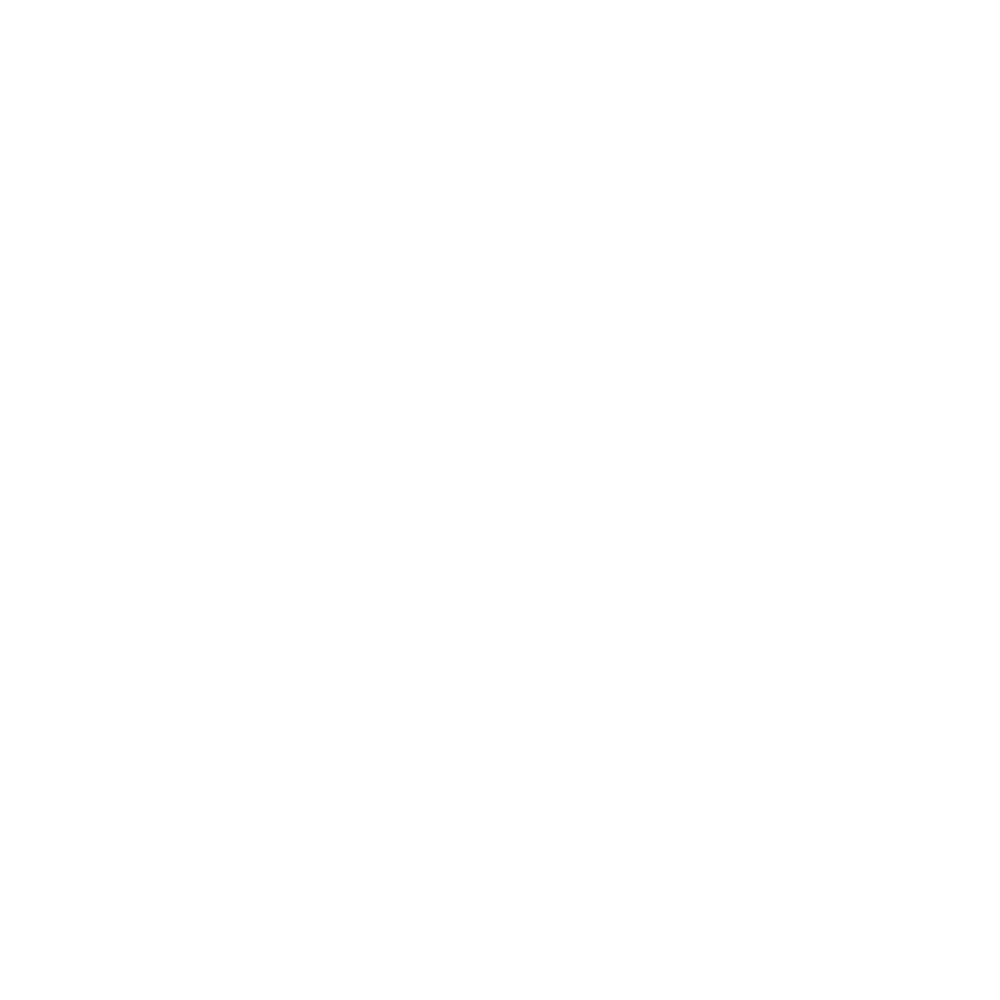

In [27]:
show_G(a_zwickau_G)

<IPython.core.display.Javascript object>


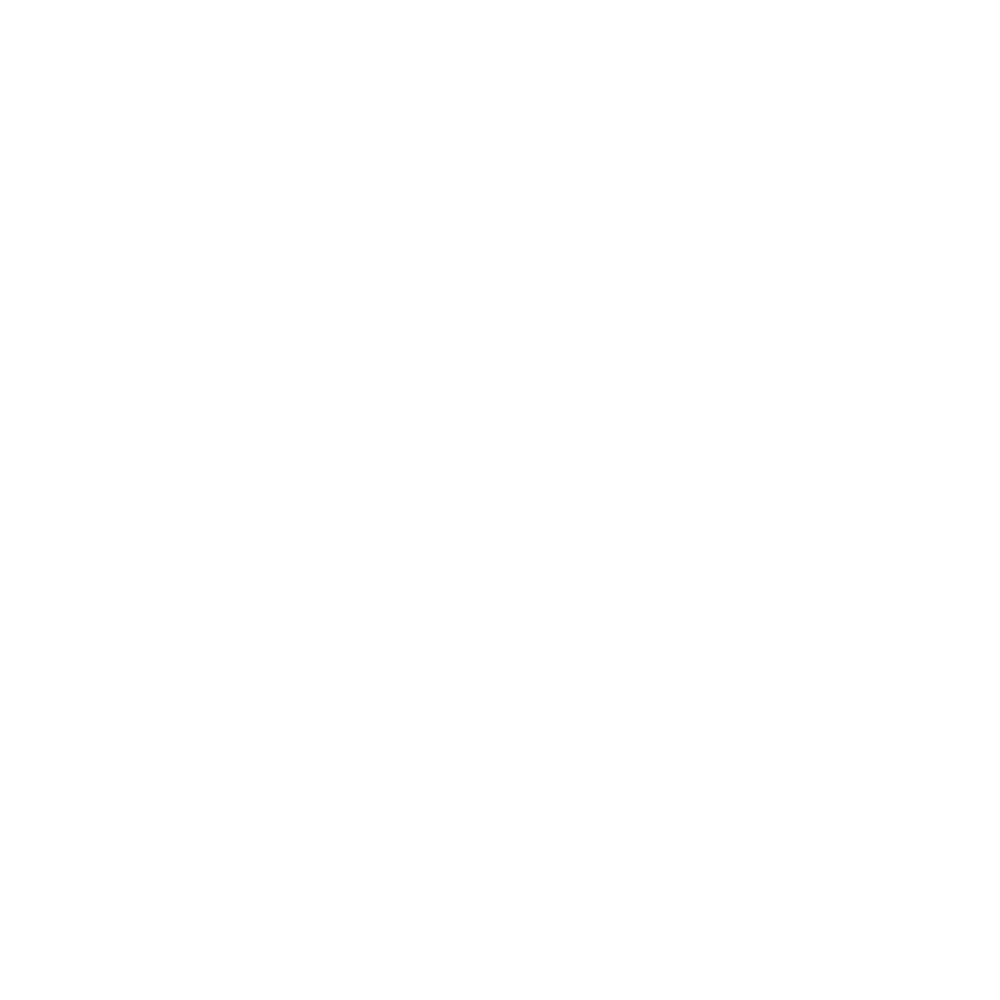

In [28]:
show_G(b_london_G)

In [29]:
%matplotlib inline
fig, axes = plt.subplots(318, 1, figsize=(20,900))
a_zwickau_similarities_df = pd.DataFrame(a_zwickau_similarities)
b_london_similarities_df = pd.DataFrame(b_london_similarities)

for i, ax in enumerate(axes.ravel()):
    ax.set_title(f'paragraph {i}')
    
    if i in list(a_zwickau_similarities_df.index):
        y_1 = a_zwickau_similarities_df.iloc[i, :]
        ax.plot(y_1, color='orange', label='a_zwickau')
    
    if i in list(b_london_similarities_df.index):
        y_2 = b_london_similarities_df.iloc[i, :]
        ax.plot(y_2, label='b_london')
        
    ax.grid()
    ax.set_ylim([0,1])
    ax.legend()

plt.show()

In [30]:
%matplotlib inline
fig, axes = plt.subplots(318, 1, figsize=(20,900))
a_zwickau_similarities_df = pd.DataFrame(a_zwickau_b_london_similarities)
b_london_similarities_df = pd.DataFrame(b_london_a_zwickau_similarities)

for i, ax in enumerate(axes.ravel()):
    ax.set_title(f'paragraph {i}')
    
    if i in list(a_zwickau_similarities_df.index):
        y_1 = a_zwickau_similarities_df.iloc[i,:]
        ax.plot(y_1, color='orange', label='a_zwickau')
    
    if i in list(b_london_similarities_df.index):
        y_2 = b_london_similarities_df.iloc[i,:]
        ax.plot(y_2, label='b_london')
        
    ax.grid()
    ax.set_ylim([0,1])
    ax.legend()

plt.show()